In [1]:
import pandas as pd
import numpy as np
import cv2
import tensorflow as tf
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import seaborn as sns

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from skimage.io import imread
from skimage.color import rgb2gray
from skimage import exposure
from skimage import color
from skimage.feature import daisy

from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score, confusion_matrix
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV

from scipy.stats import randint

2023-08-02 08:50:50.760202: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-08-02 08:50:50.789029: I tensorflow/core/platform/cpu_feature_guard.cc:183] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE3 SSE4.1 SSE4.2 AVX, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
# Load the image paths and labels from the DataFrame
df = pd.read_csv('Dataset/cards.csv')

# For column names that contain space, replace the space with an underscore
df.columns = [c.replace(' ', '_') for c in df.columns]

# Add suits column
df['suit'] = df['labels'].str.split().str[-1]

# Remove rows with jokers
df = df[~df['suit'].str.contains('joker', case=False)]

# Remove unwanted columns
df = df.drop(columns = ['data_set'])
df = df.drop(columns = ['class_index'])
df = df.drop(columns = ['labels'])
df = df.drop(columns = ['card_type'])

# Add folder name to the filepath
df['filepaths'] = df['filepaths'].apply(lambda x: 'Dataset/' + x)
df.head()

,filepaths,suit
0,Dataset/train/ace of clubs/001.jpg,clubs
1,Dataset/train/ace of clubs/002.jpg,clubs
2,Dataset/train/ace of clubs/003.jpg,clubs
3,Dataset/train/ace of clubs/004.jpg,clubs
4,Dataset/train/ace of clubs/005.jpg,clubs


In [3]:
# Split dataframe into train and test sets, stratified by the 'suit' column
train_df, test_df = train_test_split(df, test_size=0.2, stratify=df['suit'], random_state=42)

# Split train set into train and validation sets, stratified by the 'suit' column
train_df, val_df = train_test_split(train_df, test_size=0.2, stratify=train_df['suit'], random_state=42)

# Check class distribution in the train, validation, and test sets
train_class_distribution = train_df['suit'].value_counts(normalize=True)
val_class_distribution = val_df['suit'].value_counts(normalize=True)
test_class_distribution = test_df['suit'].value_counts(normalize=True)

print("Train Set - Class Distribution:")
print(train_class_distribution)

print("Validation Set - Class Distribution:")
print(val_class_distribution)

print("Test Set - Class Distribution:")
print(test_class_distribution)

Train Set - Class Distribution:
spades      0.269171
hearts      0.246010
diamonds    0.243675
clubs       0.241144
Name: suit, dtype: float64
Validation Set - Class Distribution:
spades      0.269261
hearts      0.245914
diamonds    0.243580
clubs       0.241245
Name: suit, dtype: float64
Test Set - Class Distribution:
spades      0.268991
hearts      0.245953
diamonds    0.244085
clubs       0.240971
Name: suit, dtype: float64


## Augment Images

In [4]:
# Initialize data generator class

train_data_generator = ImageDataGenerator(
#     rescale = 1/255.0,
    rotation_range= 45,
#     zoom_range= 0.2,
#     width_shift_range = 0.2,
#     height_shift_range = 0.2,
    shear_range= 0.2,
    horizontal_flip=True,
    vertical_flip=True
)

test_data_generator = ImageDataGenerator(rescale = 1/255.0)

# Create data generators for train, validation, and test
batch_size = 32

train_generator = train_data_generator.flow_from_dataframe(
    dataframe = train_df,
    x_col = 'filepaths',
    y_col = 'suit',
    target_size = (224,224),
    batch_size = batch_size,
    class_mode = 'categorical'
)

valid_generator = train_data_generator.flow_from_dataframe(
    dataframe = val_df,
    x_col = 'filepaths',
    y_col = 'suit',
    target_size = (224,224),
    batch_size = batch_size,
    class_mode = 'categorical'
)


test_generator = test_data_generator.flow_from_dataframe(
    dataframe = test_df,
    x_col = 'filepaths',
    y_col = 'suit',
    target_size = (224,224),
    batch_size = batch_size,
    class_mode = 'categorical',
    shuffle = False,
)


Found 5138 validated image filenames belonging to 4 classes.
Found 1285 validated image filenames belonging to 4 classes.
Found 1606 validated image filenames belonging to 4 classes.


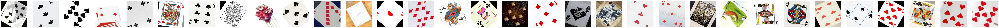

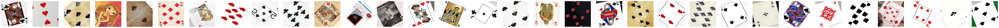

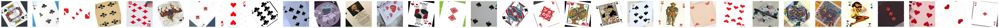

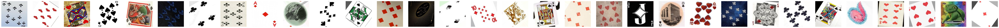

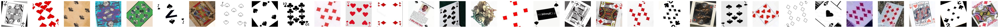

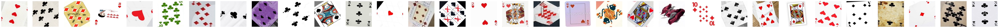

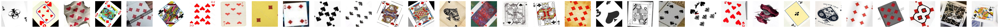

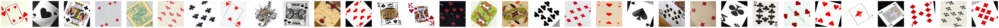

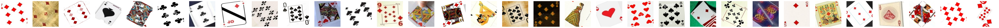

In [5]:
# Plot augmented images from a sample of 10 batches
for batch_index in range(1,10):
    image_batch, label_batch = next(train_generator)
    num_images_in_batch = image_batch.shape[0]

    plt.figure(figsize=(100, 8))
    for i in range(num_images_in_batch):
        plt.subplot(1, num_images_in_batch, i + 1)
        plt.imshow(image_batch[i].astype('uint8'))
        plt.axis('off')
    plt.show()

## Load, Preprocess, and Extract

In [6]:
def load_and_preprocess_image(filepath):
    image = cv2.imread(filepath)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    image = cv2.resize(image, (224, 224))
    image_norm = image.astype('float32')
    norm = image_norm / 255.0
    return norm

# Convert images to grayscale
def convert_to_grayscale(images):
    gray_images = np.array([cv2.cvtColor(img, cv2.COLOR_RGB2GRAY) for img in images])
    return gray_images

# Extract Daisy features
def extract_daisy_features(images):
    daisy_features = []
    for img in images:
        daisy_feature = daisy(img, step=16, radius=15, rings=2, histograms=8,
                              orientations=8, visualize=False)
        daisy_features.append(daisy_feature.reshape(-1))
    return np.array(daisy_features)

## Extract Feature

In [7]:
# Load data from the generators and extract HOG features
train_images = np.array([load_and_preprocess_image(train_generator.filepaths[i]) for i in range(len(train_generator.filenames))])
valid_images = np.array([load_and_preprocess_image(valid_generator.filepaths[j]) for j in range(len(valid_generator.filenames))])
test_images = np.array([load_and_preprocess_image(test_generator.filepaths[k]) for k in range(len(test_generator.filenames))])

# Convert to grayscale
train_gray_images = convert_to_grayscale(train_images)
valid_gray_images = convert_to_grayscale(valid_images)
test_gray_images = convert_to_grayscale(test_images)

# Extract HOG feature vectors
train_hog_features = extract_daisy_features(train_gray_images)
valid_hog_features = extract_daisy_features(valid_gray_images)
test_hog_features = extract_daisy_features(test_gray_images)

# Convert labels to arrays and one-hot encode 
train_labels = to_categorical(train_generator.labels, num_classes=4)
valid_labels = to_categorical(valid_generator.labels, num_classes=4)
test_labels = to_categorical(test_generator.labels, num_classes=4)


## Random Forest Model with Hyperparameter Search

In [9]:
# Define the parameter distributions for Random Search
param_dist = {
    'n_estimators': randint(100, 1000),  # Number of trees in the forest
    'max_depth': [None] + list(range(10, 110, 10)),  # Maximum depth of the tree
    'min_samples_split': randint(2, 11),  
    'min_samples_leaf': randint(1, 11) 
}

# Initialize the Random Forest classifier
rf_classifier = RandomForestClassifier(random_state=42)

# Create a RandomizedSearchCV object
random_search = RandomizedSearchCV(rf_classifier, param_distributions=param_dist, n_iter=10, cv=3, n_jobs=-1)

# Train the Random Search on train_hog_features and train_labels
random_search.fit(train_hog_features, train_generator.labels)

# Print the best hyperparameters found by Random Search
print("Best hyperparameters:", random_search.best_params_)

Best hyperparameters: {'max_depth': 40, 'min_samples_leaf': 2, 'min_samples_split': 10, 'n_estimators': 584}


In [10]:
# Get the best Random Forest classifier
best_rf_classifier = random_search.best_estimator_

In [11]:
# Evaluate the best Random Forest classifier on the validation set
valid_accuracy = best_rf_classifier.score(valid_hog_features, valid_generator.labels)
print("Validation Accuracy:", valid_accuracy)

Validation Accuracy: 0.709727626459144


In [12]:
# Evaluate the best Random Forest classifier on the test set
test_accuracy = best_rf_classifier.score(test_hog_features, test_generator.labels)
print("Test Accuracy:", test_accuracy)

Test Accuracy: 0.6855541718555417


## Classification Report

In [13]:
# Predict labels for the test set using the best SVM classifier
test_predictions = best_rf_classifier.predict(test_hog_features)

In [14]:
# Print the classification report
print("Classification Report:")
print(classification_report(test_generator.labels, test_predictions))

Classification Report:
              precision    recall  f1-score   support

           0       0.64      0.65      0.65       387
           1       0.70      0.69      0.70       392
           2       0.72      0.67      0.69       395
           3       0.68      0.73      0.70       432

    accuracy                           0.69      1606
   macro avg       0.69      0.68      0.68      1606
weighted avg       0.69      0.69      0.69      1606



## Confusion Matrix

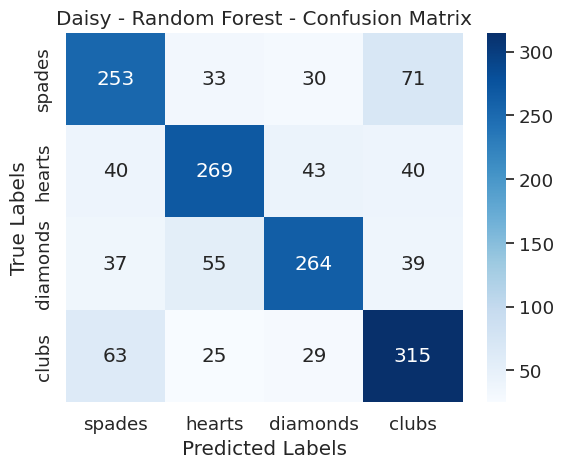

In [16]:
conf_matrix = confusion_matrix(test_generator.labels, test_predictions)

# Define the class labels
class_labels = ['spades', 'hearts', 'diamonds', 'clubs']

# Create the seaborn heatmap
sns.set(font_scale=1.2)
sns.heatmap(conf_matrix, 
            annot=True, 
            fmt="d", 
            cmap="Blues", 
            xticklabels=class_labels, 
            yticklabels=class_labels)

# Add labels and title
plt.xlabel("Predicted Labels")
plt.ylabel("True Labels")
plt.title("Daisy - Random Forest - Confusion Matrix")

# Show the plot
plt.show()